In [ ]:
# General
import argparse
import os
import random

# torch imports
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils

# maths
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import numpy as np
from IPython.display import HTML
%matplotlib inline

manualSeed = 999
print('Random seed: ', manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random seed:  999


Setting up parameters for the project (based on DCGAN paper).

In [ ]:
# Root directory for dataset
dataroot = 'data'

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 128

# Spatial size of training images.
# All images will be resized to this using a transformer.
image_size = 64

# Number of channels in the training images. For colored ones, this is 3.
n_channels = 3

# Size of z latent vector (size of generator input)
n_z = 100

# Size of feature maps in generator
n_generator_feature = 64

# Size of feature maps in discriminator
n_discriminator_feature = 64

# Number of training epochs
num_epochs = 100

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available (0 for cpu).
ngpu = 1

## Download the celebrity dataset.

In [ ]:
# Check if dataset is already download
! du -sh data/celeba

du: cannot access 'data/celeba': No such file or directory


In [ ]:
! pip install gdown
import gdown

# url = 'https://drive.google.com/uc?id=0B7EVK8r0v71pZjFTYXZWM3FlRnM'
# Podaci preuzeti sa repozitorijuma: https://github.com/Mckinsey666/Anime-Face-Dataset
url = 'https://drive.google.com/uc?id=1jdJXkQIWVGOeb0XJIXE3YuZQeiEPd8rM&export=download'
output = 'data.zip'
gdown.download(url, output, quiet=False)

Downloading...
From: https://drive.google.com/uc?id=1jdJXkQIWVGOeb0XJIXE3YuZQeiEPd8rM&export=download
To: /content/data.zip
231MB [00:01, 192MB/s]


'data.zip'

In [ ]:
%%capture
! unzip data.zip
! mkdir data/anime
! mv data/* data/anime

In [ ]:
! ls data
# ! du -sh data/celeba

anime


## Working with dataset

This is an important step because we will be using the `ImageFolder` dataset class, which requires there to be subdirectories in the dataset’s root folder. Now, we can create the dataset, create the dataloader, set the device to run on, and finally visualize some of the training data.

In [ ]:
dataset = dset.ImageFolder(
    root=dataroot,
    transform=transforms.Compose([
        transforms.Resize(image_size),
        transforms.CenterCrop(image_size),
        transforms.ToTensor(),
        transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))                              
    ])
)

dataloader = torch.utils.data.DataLoader(
    dataset,
    batch_size=batch_size,
    shuffle=True,
    num_workers=workers
)

# Decide on which device to perform calculations
device = torch.device('cuda:0' if (torch.cuda.is_available() and ngpu > 0) else 'cpu')

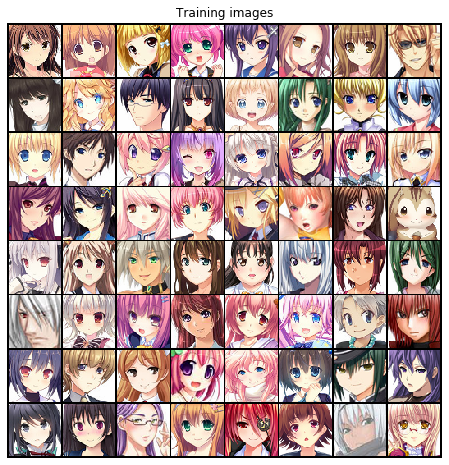

In [ ]:
# Plot some images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis('off')
plt.title('Training images')
plt.imshow(
    np.transpose(
        vutils.make_grid(
            real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),
            (1, 2, 0)
    )
)

## Weight initialization

From the DCGAN paper, the authors specify that all model weights shall be 
randomly initialized from a Normal distribution with mean=0, stdev=0.02.

The `weights_init` function takes an initialized model as input and reinitializes all convolutional, convolutional-transpose, and batch normalization layers to meet this criteria. This function is applied to the models immediately after initialization.

In [ ]:
# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

## Generator
The generator, $G$, is designed to map the latent space vector ($z$) to data-space.
Since our data are images, converting $z$ to data-space means ultimately
creating a RGB image with the same size as the training images ($3\times64\times64$).

In practice, this is accomplished **through a series of stride 2 convolutional
transpose layers, each paired with a 2d batch norm layer and relu activation**.

The output of the generator is fed through a `tanh` function to return it to
the input data range of $[-1, 1]$.

**It is worth noting the existance of the batch norm functions after the
conv-transpose layers, as this is a critical contribution of the DCGAN paper.**

These layers help with the flow of gradients during training. An image from
the DCGAN paper is shown bellow.

![alt text](https://pytorch.org/tutorials/_images/dcgan_generator.png)

Notice, the how the inputs we set in the input section (nz, ngf, and nc) influence the generator architecture in code. nz is the length of the z input vector, ngf relates to the size of the feature maps that are propagated through the generator, and nc is the number of channels in the output image (set to 3 for RGB images). Below is the code for the generator.

In [ ]:
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input iz Z, going into convolution
            nn.ConvTranspose2d(in_channels=n_z, out_channels=n_generator_feature * 8, kernel_size=4, stride=1, padding=0, bias=False),
            nn.BatchNorm2d(n_generator_feature * 8),
            nn.ReLU(inplace=True),

            # state size. (n_generator_feature * 8) x 4 x 4
            nn.ConvTranspose2d(n_generator_feature * 8, n_generator_feature * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(n_generator_feature * 4),
            nn.ReLU(inplace=True),

            # state size. (n_generator_feature * 8) x 8 x 8
            nn.ConvTranspose2d(n_generator_feature * 4, n_generator_feature * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(n_generator_feature * 2),
            nn.ReLU(inplace=True),

            # state size. (n_generator_feature * 2) x 16 x 16
            nn.ConvTranspose2d(n_generator_feature * 2, n_generator_feature, 4, 2, 1, bias=False),
            nn.BatchNorm2d(n_generator_feature),
            nn.ReLU(inplace=True),

            # state size. (n_generator_feature) x 32 x 32
            nn.ConvTranspose2d(n_generator_feature, n_channels, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (n_channels) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)


In [ ]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 0):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netG.apply(weights_init)

# Show the model
print(netG)

DataParallel(
  (module): Generator(
    (main): Sequential(
      (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): ReLU(inplace=True)
      (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (8): ReLU(inplace=True)
      (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (11): ReLU(inplace=True)
      (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2

## Discriminator

As mentioned, the discriminator, $D$, is a binary classification network that takes an image as input and outputs a scalar probability that the input image is real (as opposed to fake). Here, D takes a $3\times64\times64$ input image, processes it through a series of `Conv2d`, `BatchNorm2d`, and `LeakyReLU` layers, and outputs the final probability through a *Sigmoid* activation function. This architecture can be extended with more layers if necessary for the problem, but there is significance to the use of the strided convolution, `BatchNorm`, and `LeakyReLUs`.

**The DCGAN paper mentions it is a good practice to use strided convolution rather than pooling to downsample because it lets the network learn its own pooling function**. Also batch norm and leaky relu functions promote healthy gradient flow which is critical for the learning process of both G and D.

In [ ]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (n_channels) x 64 x 64
            nn.Conv2d(n_channels, n_discriminator_feature, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (n_discriminator_feature) x 32 x 32
            nn.Conv2d(n_discriminator_feature, n_discriminator_feature * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(n_discriminator_feature * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (n_discriminator_feature*2) x 16 x 16
            nn.Conv2d(n_discriminator_feature * 2, n_discriminator_feature * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(n_discriminator_feature * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (n_discriminator_feature*4) x 8 x 8
            nn.Conv2d(n_discriminator_feature * 4, n_discriminator_feature * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(n_discriminator_feature * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (n_discriminator_feature*8) x 4 x 4
            nn.Conv2d(n_discriminator_feature * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [ ]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


## Loss Functions and Optimizers

With $D$ and $G$ setup, we can specify how they learn through the loss functions and optimizers. We will use the Binary Cross Entropy loss (`BCELoss`)
function which is defined in PyTorch as:
$$
\ell(x, y) = L = (l_1, \ldots, l_N)^T, l_n = -[y_N \cdot log x_n + (1-y_N) \cdot log(1 - x_n)]
$$


Notice how this function provides the calculation of both log components
in the objective function ($log(D(x))$ and $log(1-D(G(z))$). We can specify
what part of the BCE equation to use with the $y$ input.
This is accomplished in the training loop which is coming up soon, but
it is important to understand how we can choose which component we wish to
calculate just by changing $y$.

Next, we define our real label as 1 and the fake label as 0. These labels
will be used when calculating the losses of $D$ and $G$, and this is also
the convention used in the original GAN paper. Finally, we set up two
separate optimizers, one for $D$ and one for $G$. As specified in the original
DCGAN paper, both are Adam optimizers with learning rate 0.0002 and Beta1 = 0.5.
For keeping track of the generator's learning progression, we will generatoe a
fixed batch of latent vectors that are drawn from a Gaussian distribution.
In the training loop, we will periodically input this fixed noise into $G$,
and over the iterations we will see images form out of the noise.

In [ ]:
# Initialize the BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
# the progression of the generator
fixed_noise = torch.randn(64, n_z, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1
fake_label = 0

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

## Training

Finally, now that we have all of the parts of the GAN framework defined, we can train it. Be mindful that training GANs is somewhat of an art form, as incorrect hyperparameter settings lead to mode collapse with little explanation of what went wrong. Here, we will closely follow Algorithm 1 from Goodfellow’s paper, while abiding by some of the best practices shown in [ganhacks](https://github.com/soumith/ganhacks). Namely, we will “construct different mini-batches for real and fake” images, and also adjust $G$’s objective function to maximize $log D(G(z))$. Training is split up into two main parts. Part 1 updates the Discriminator and Part 2 updates the Generator.

### Part 1 - Train the Discriminator

Recall, the goal of training the discriminator is to maximize the probability of correctly classifying a given input as real or fake. In terms of Goodfellow, we wish to “update the discriminator by *ascending its stochastic gradient”*. 
Practically, we want to maximize $log(D(x))+log(1−D(G(z)))$.
Due to the separate mini-batch suggestion from ganhacks, we will calculate this in **two steps**. **First**, we will construct a batch of real samples from the training set, forward pass through $D$, calculate the loss $(log(D(x)))$, then calculate the gradients in a backward pass.
**Secondly**, we will construct a batch of fake samples with the current generator, forward pass this batch through $D$, calculate the loss $(log(1−D(G(z))))$, and accumulate the gradients with a backward pass.
Now, with the gradients accumulated from both the all-real and all-fake batches, we call a step of the Discriminator’s optimizer.


### Part 2- Train the Generator

As stated in the original paper, we want to train the Generator by minimizing $log(1−D(G(z)))$ in an effort to generate better fakes.

As mentioned, this was shown by Goodfellow to not provide sufficient gradients, especially early in the learning process. As a fix, we instead wish to maximize $log(D(G(z)))$.
In the code we accomplish this by: classifying the Generator output from Part 1 with the Discriminator, computing $G$’s loss using real labels as ground-truth, computing $G$’s gradients in a backward pass, and finally updating $G$’s parameters with an optimizer step.
It may seem counter-intuitive to use the real labels as GT labels for the loss function, but this allows us to use the $log(x)$ part of the BCELoss (rather than the log(1−x) part) which is exactly what we want.

Finally, we will do some statistic reporting and at the end of each epoch we will push our fixed_noise batch through the generator to visually track the progress of G’s training. The training statistics reported are:

- **Loss_D** - discriminator loss calculated as the sum of losses for the all real and all fake batches ($log(D(x))+log(D(G(z)))$).
- **Loss_G** - generator loss calculated as $log(D(G(z)))$
- **D(x)** - the average output (across the batch) of the discriminator for the all real batch. This should start close to 1 then theoretically converge to 0.5 when G gets better. Think about why this is.
- **D(G(z))** - average discriminator outputs for the all fake batch. The first number is before D is updated and the second number is after D is updated. These numbers should start near 0 and converge to 0.5 as G gets better. Think about why this is.

In [ ]:
# Training loop

# Lists that help keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print('Starting training loop...')

for epoch in range(num_epochs):
    # For each batch from the dataloader
    for i, data in enumerate(dataloader, 0):

        # ----------------------------------------------------------------------
        # (1) Update D: maximize log(D(x)) + log(1 - D(g(z)))
        # ----------------------------------------------------------------------
        netD.zero_grad()

        ## --------------------------
        ## Train with all-real batch
        ## --------------------------
        # format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, device=device)

        # forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # calculate loss on all-real batch
        errD_real = criterion(output, label)
        # calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## --------------------------
        ## Train with all-fake batch
        ## --------------------------
        noise = torch.randn(b_size, n_z, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D (TODO: what is `detach`?)
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate gradients for this batch
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Add the errors from all-real and all-fake batches together
        errD = errD_real + errD_fake

        # Update D
        optimizerD.step()

        # ----------------------------------------------------------------------
        # (2) Update G: maximize log(D(G(z)))
        # ----------------------------------------------------------------------
        netG.zero_grad()
        # fake labels are real for generator cost
        label.fill_(real_label)
        # We just update D, perform a new pass of the fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Log training
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting training loop...
[0/100][0/169]	Loss_D: 1.6886	Loss_G: 2.0477	D(x): 0.3502	D(G(z)): 0.2659 / 0.1726
[0/100][50/169]	Loss_D: 3.0689	Loss_G: 13.7757	D(x): 0.2639	D(G(z)): 0.0000 / 0.0000
[0/100][100/169]	Loss_D: 0.4274	Loss_G: 8.0631	D(x): 0.8269	D(G(z)): 0.0458 / 0.0008
[0/100][150/169]	Loss_D: 0.4088	Loss_G: 4.1067	D(x): 0.8201	D(G(z)): 0.0953 / 0.0279
[1/100][0/169]	Loss_D: 0.6274	Loss_G: 4.8375	D(x): 0.7958	D(G(z)): 0.1227 / 0.0141
[1/100][50/169]	Loss_D: 1.4515	Loss_G: 8.8742	D(x): 0.8973	D(G(z)): 0.6417 / 0.0004
[1/100][100/169]	Loss_D: 1.0669	Loss_G: 9.2235	D(x): 0.9280	D(G(z)): 0.5437 / 0.0006
[1/100][150/169]	Loss_D: 0.7539	Loss_G: 8.1596	D(x): 0.9035	D(G(z)): 0.4189 / 0.0006
[2/100][0/169]	Loss_D: 0.2141	Loss_G: 3.5928	D(x): 0.8793	D(G(z)): 0.0494 / 0.0514
[2/100][50/169]	Loss_D: 0.4177	Loss_G: 3.8907	D(x): 0.9355	D(G(z)): 0.2609 / 0.0324
[2/100][100/169]	Loss_D: 1.2397	Loss_G: 9.6235	D(x): 0.8598	D(G(z)): 0.5883 / 0.0001
[2/100][150/169]	Loss_D: 0.5036	Loss_G: 6.5380	

### Results
Finally, lets check out how we did. Here, we will look at three different results. First, we will see how D and G’s losses changed during training. Second, we will visualize G’s output on the fixed_noise batch for every epoch. And third, we will look at a batch of real data next to a batch of fake data from G.

#### Loss versus training iteration

Below is a plot of D & G’s losses versus training iterations.

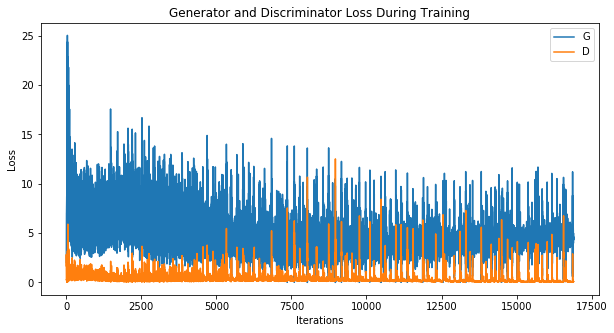

In [ ]:
plt.figure(figsize=(10, 5))
plt.title('Generator and Discriminator Loss During Training')
plt.plot(G_losses, label='G')
plt.plot(D_losses, label='D')
plt.xlabel('Iterations')
plt.ylabel('Loss')
plt.legend()
plt.show()

#### Visualization of G’s progression

Remember how we saved the generator’s output on the fixed_noise batch after every epoch of training. Now, we can visualize the training progression of G with an animation. Press the play button to start the animation.

Animation size has reached 21214755 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


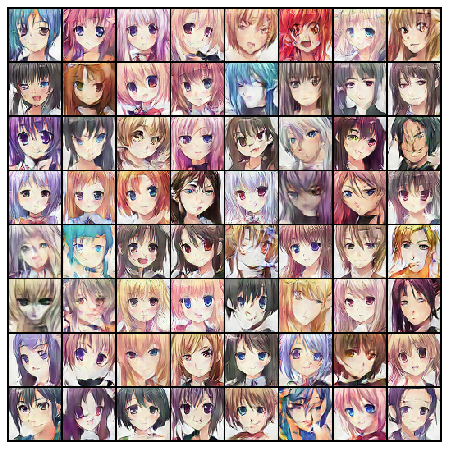

In [ ]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

### Real Images vs. Fake Images

Finally, lets take a look at some real images and fake images side by side.

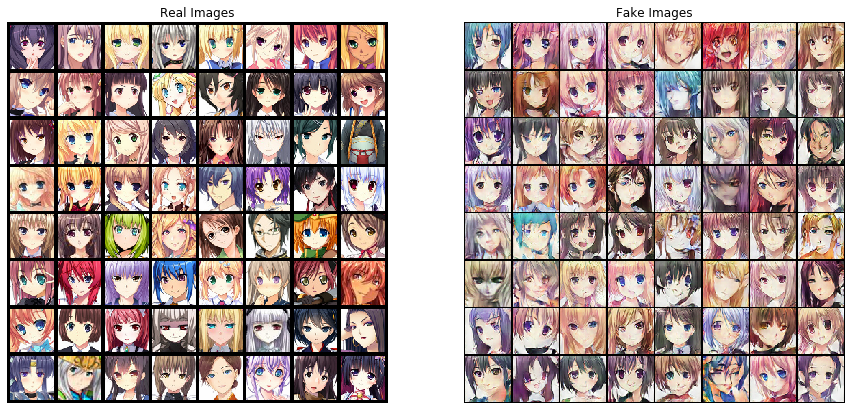

In [ ]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()